# **SDC Advanced Lane Lines** 
## Overview 
Develop a pipeline to identify the lane boundaries from a front-facing camera on a car. Extensive use of OpenCV, matplotlib, numpy will be used.

The steps are as follows :
- Camera Calibration 
- Distortion Correction.
- Perspective Transform (Birds eye view)
- Explore Color spaces on birds eye view
- Gradient and Color Threshold.
- Detect lanes using `blind_search()` and visualize them. 
- Detect lanes using `found_search()` and visualize them. 
- Determine the radius of curvature and center offset for the car.
- Create a Class Line(). 
- Create a video pipeline.
- Run the video pipeline for each video

## Import Packages

In [1]:
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import numpy as np
import cv2
import os
import glob
from enum import Enum
from moviepy.editor import VideoFileClip
from IPython.display import HTML
%matplotlib inline

## Camera Calibration

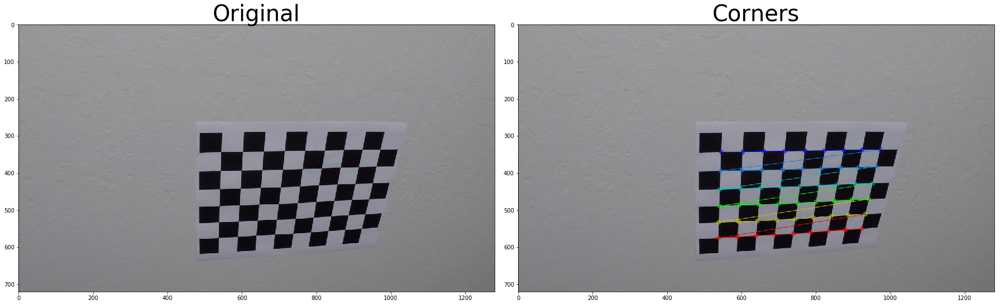

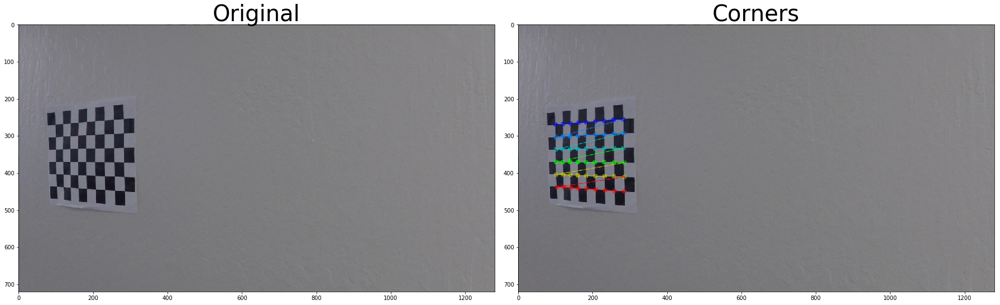

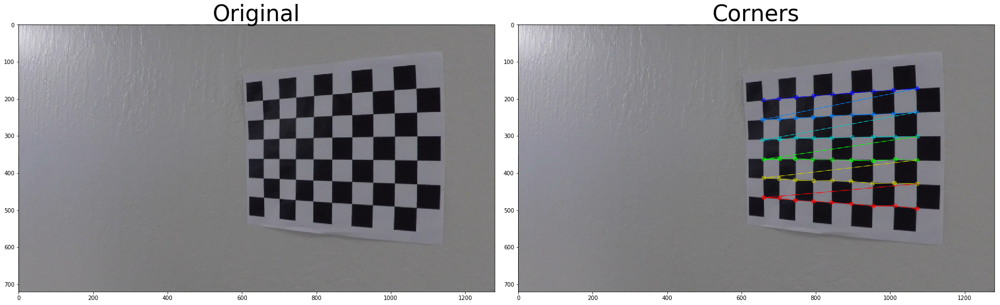

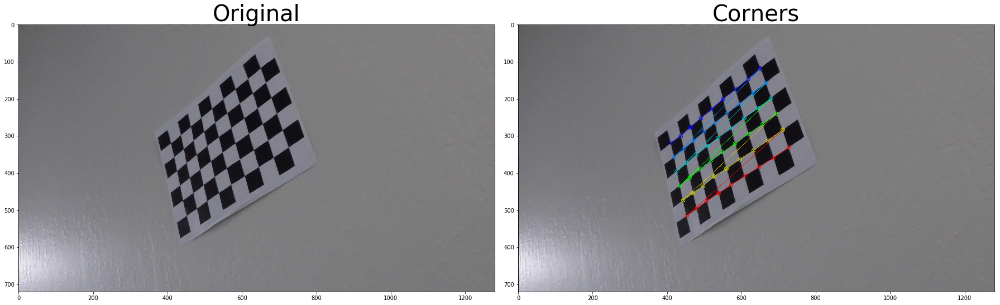

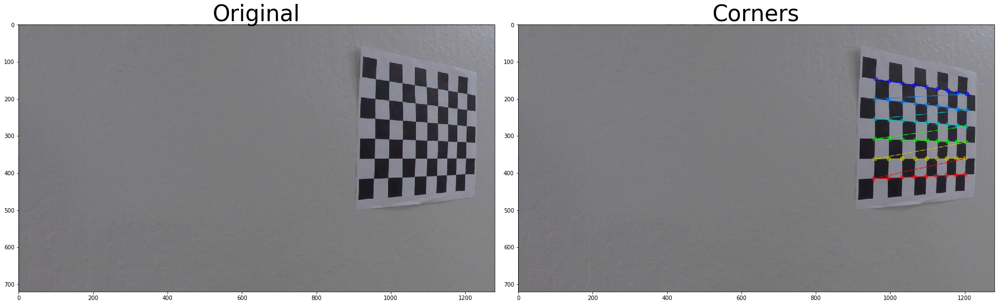

...

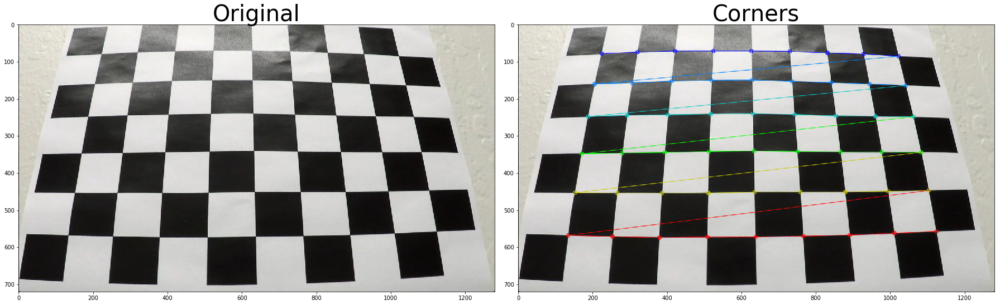

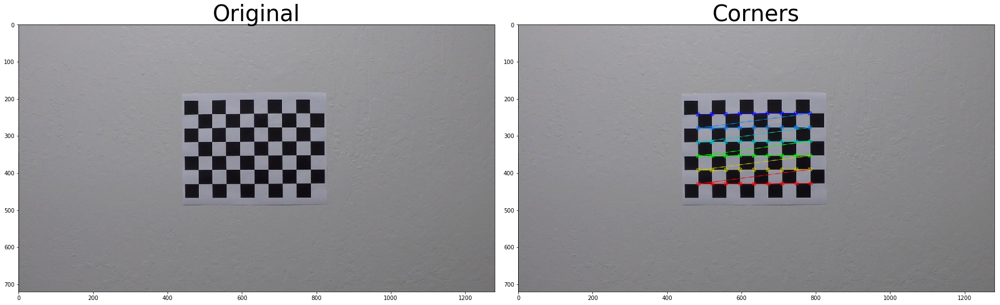

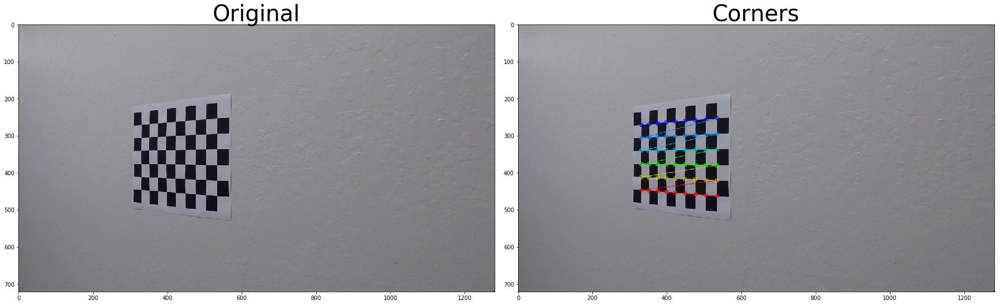

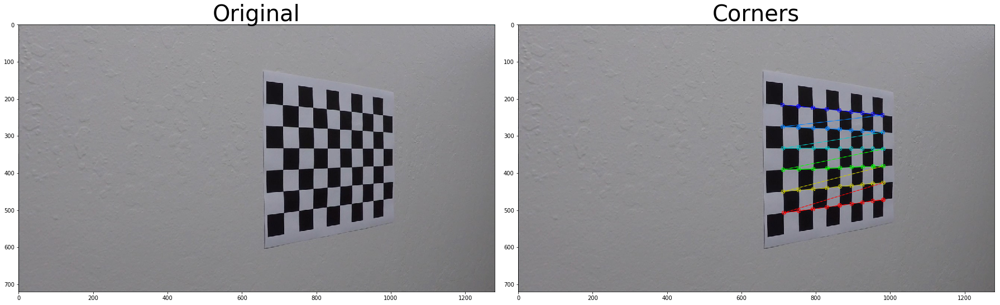

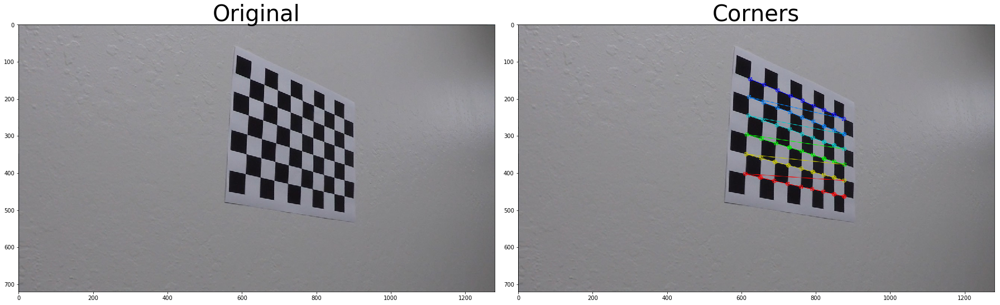

In [2]:
# prepare object points
nx = 9 # The number of inside corners in x
ny = 6 # The number of inside corners in y

objp = np.zeros((nx*ny,3), np.float32)
objp[:,:2] = np.mgrid[0:nx, 0:ny].T.reshape(-1,2)

# Arrays to store object points and image points from all the images.
objpoints = [] # 3d points in real world space
imgpoints = [] # 2d points in image plane.    

def calibrate_camera( img, plot=False ):
    # Convert to grayscale
    gray = cv2.cvtColor( img, cv2.COLOR_BGR2GRAY )
    # Find the chessboard corners
    ret, corners = cv2.findChessboardCorners( gray, ( nx, ny ), None )
    # If found, draw corners
    if ret == True:
        # Draw and display the corners
        objpoints.append( objp )
        imgpoints.append( corners )
        cv2.drawChessboardCorners( img, ( nx, ny ), corners, ret)
        if plot:
            f, (ax1, ax2) = plt.subplots( 1, 2, figsize=( 25, 10 ) )
            f.subplots_adjust( hspace = .2, wspace=.05 )
            f.tight_layout()
            ax1.imshow( mpimg.imread( path ) )
            ax1.set_title( 'Original', fontsize=40 )
            ax2.imshow( img )
            ax2.set_title( 'Corners', fontsize=40 );

for path in sorted( glob.glob('camera_cal/calibration*.jpg')):
    img = mpimg.imread( path ) 
    calibrate_camera( img, plot=True )

## Distortion Correction

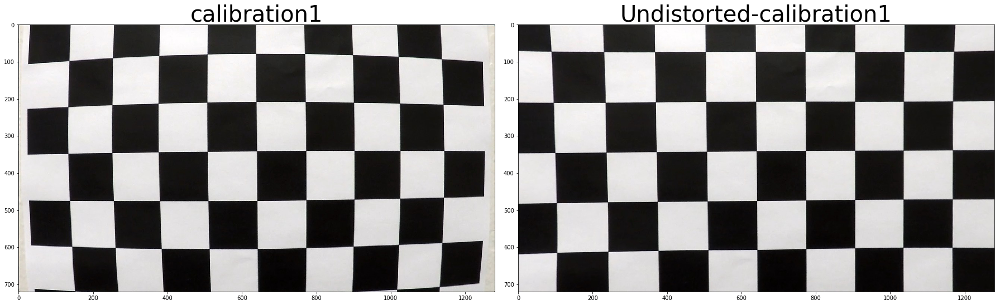

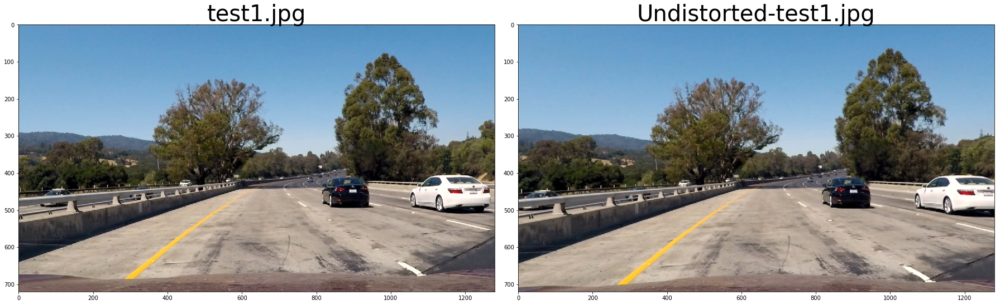

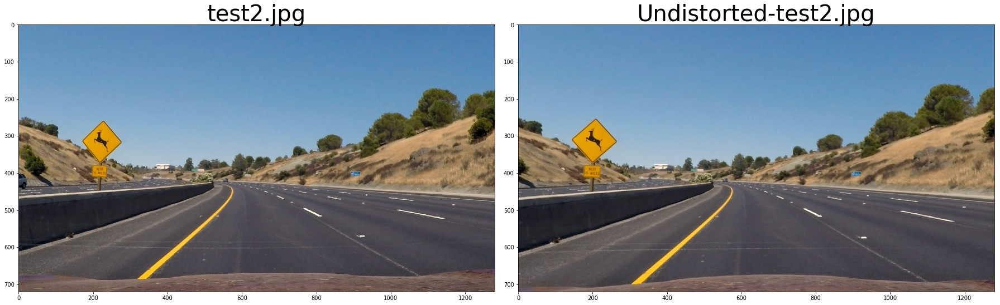

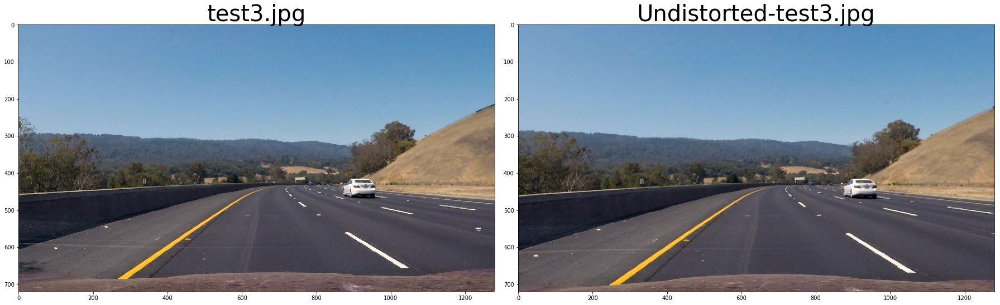

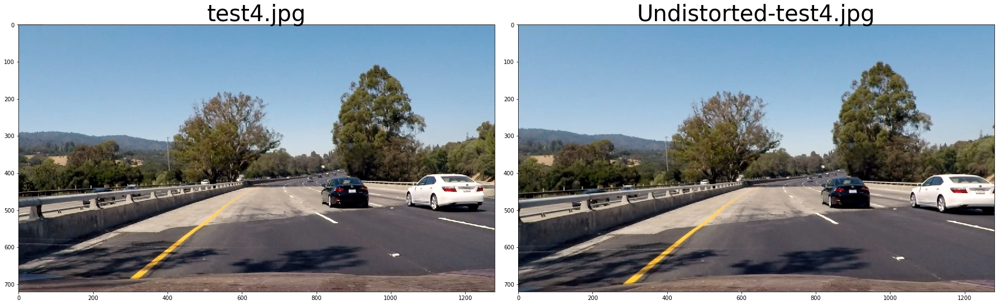

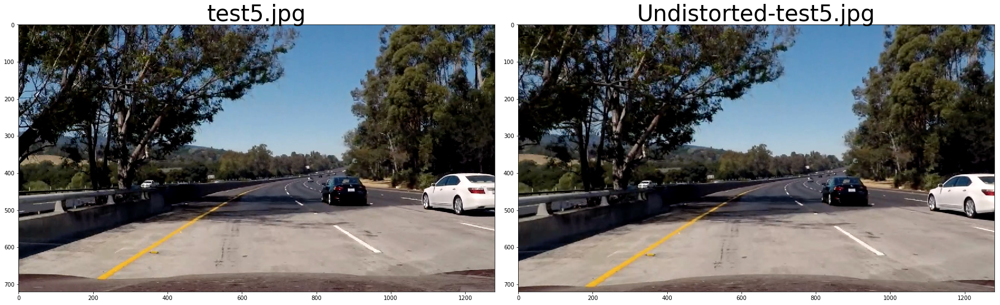

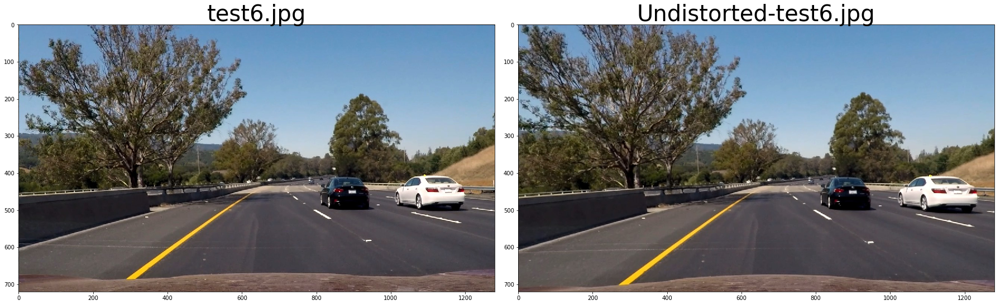

In [3]:
#
# Sanity check the distortion correction on a single calibration image
#
def correct_distortion( img ):
    gray = cv2.cvtColor( img, cv2.COLOR_BGR2GRAY )
    ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, gray.shape[::-1], None, None)
    undistorted_img = cv2.undistort(img, mtx, dist, None, mtx)
    return undistorted_img

img = mpimg.imread( 'camera_cal/calibration1.jpg' ) 
undistorted_img = correct_distortion( img )
f, (ax1, ax2) = plt.subplots( 1, 2, figsize=( 25, 10 ) )
f.subplots_adjust( hspace = .2, wspace=.05 )
f.tight_layout()
ax1.imshow( img )
ax1.set_title( 'calibration1', fontsize=40 )
ax2.imshow( undistorted_img )
ax2.set_title( 'Undistorted-calibration1', fontsize=40 );

#
# View distortion correction on all test images
#
for path in sorted( glob.glob('test_images/test*.jpg')):
    img = mpimg.imread( path ) 
    _, filename = os.path.split( path )        
    undistorted_img = correct_distortion( img )
    f, (ax1, ax2) = plt.subplots( 1, 2, figsize=( 25, 10 ) )
    f.subplots_adjust( hspace = .2, wspace=.05 )
    f.tight_layout()
    ax1.imshow( img )
    ax1.set_title( filename, fontsize=40 )
    ax2.imshow( undistorted_img )
    ax2.set_title( 'Undistorted-'+filename, fontsize=40 );        

## Perspective Transform (Birds eye view)

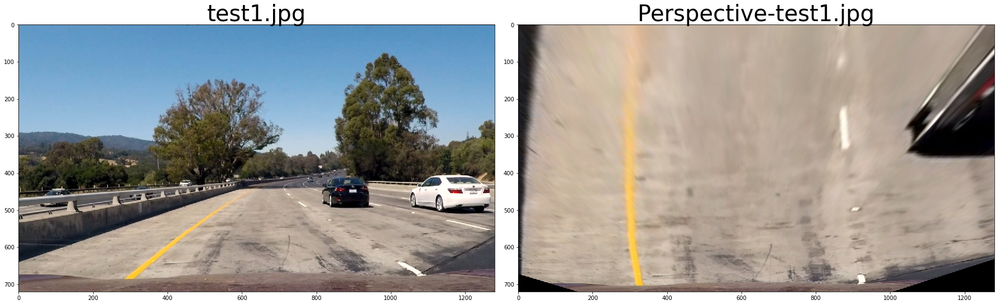

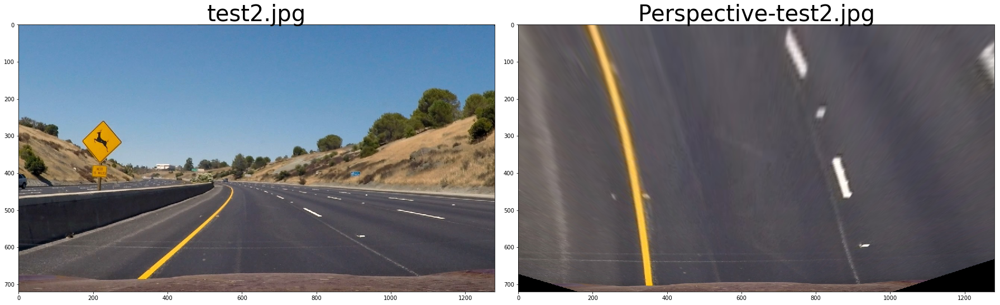

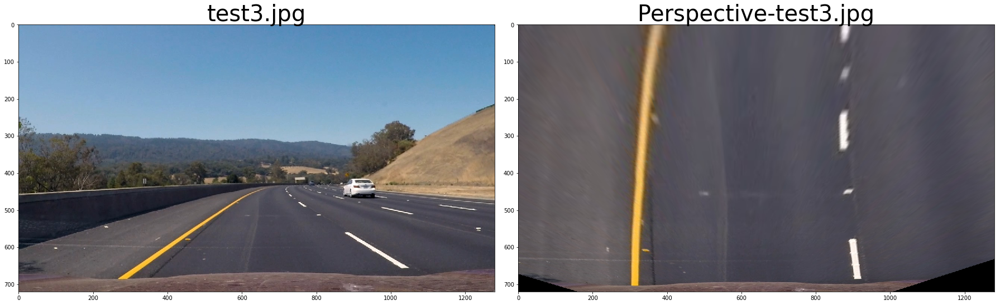

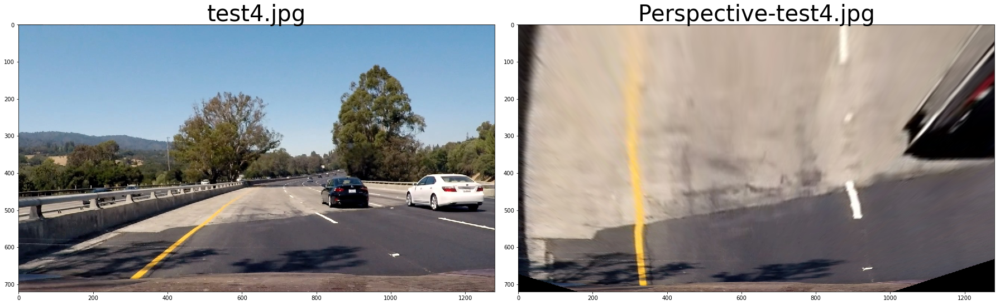

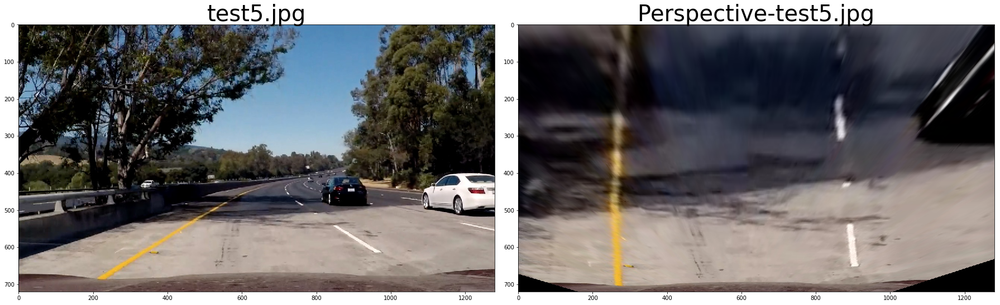

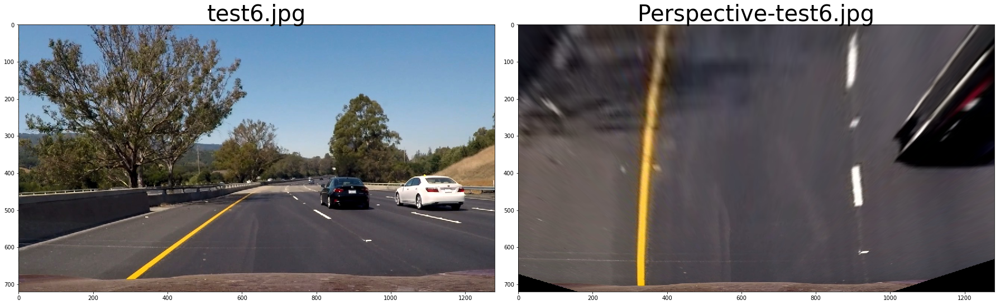

In [4]:
def perspective_transform( img ):
    """ Apply cv2.warpPerspective to get birds eye view """
    rows = img.shape[0]
    cols = img.shape[1]
    src_upper_left  = [600, rows/2+100]
    src_upper_right = [740, rows/2+100]
    src_lower_left  = [240, rows]
    src_lower_right = [1150,rows]
    src = np.float32( [ src_lower_left, src_lower_right, src_upper_right, src_upper_left ] )
    dst_upper_left  = [320,  1]
    dst_upper_right = [920,  1]
    dst_lower_left  = [320,720]
    dst_lower_right = [920,720]
    dst = np.float32( [ dst_lower_left, dst_lower_right, dst_upper_right, dst_upper_left])
    
    M = cv2.getPerspectiveTransform( src, dst )
    Minv = cv2.getPerspectiveTransform(dst, src)
    warped_img = cv2.warpPerspective( img, M, ( cols,rows ), flags=cv2.INTER_LINEAR )
    return warped_img, Minv
    
for path in sorted( glob.glob('test_images/test*.jpg')):
    img = mpimg.imread( path ) 
    _, filename = os.path.split( path )        
    warped_img,Minv = perspective_transform( img )
    f, (ax1, ax2) = plt.subplots( 1, 2, figsize=( 25, 10 ) )
    f.subplots_adjust( hspace = .2, wspace=.05 )
    f.tight_layout()
    ax1.imshow( img )
    ax1.set_title( filename, fontsize=40 )
    ax2.imshow( warped_img )
    ax2.set_title( 'Perspective-'+filename, fontsize=40 );     
 

## Explore Color Spaces on Birds Eye View

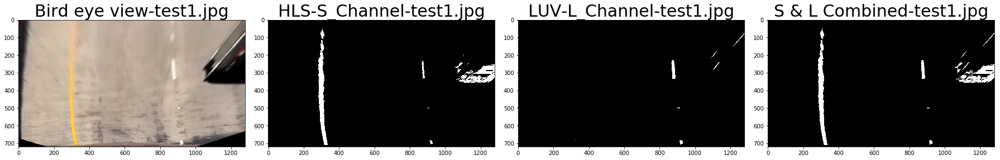

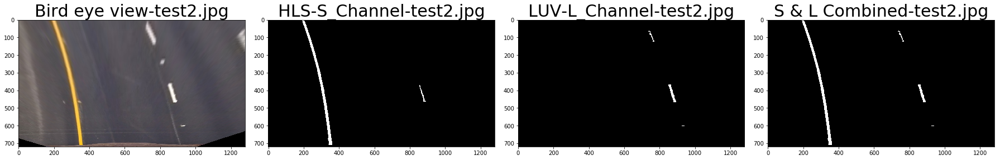

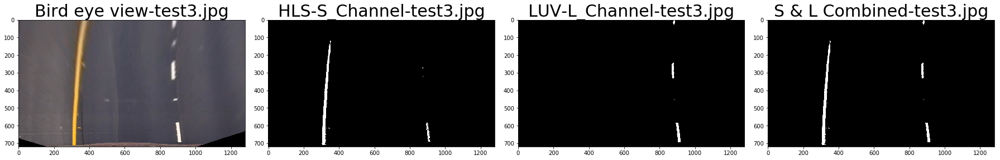

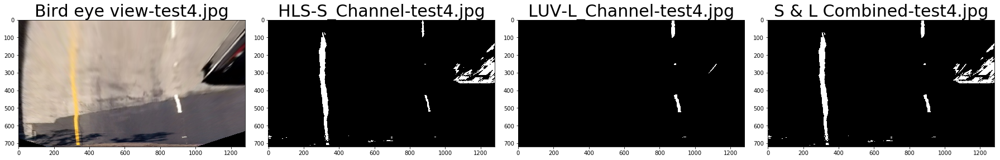

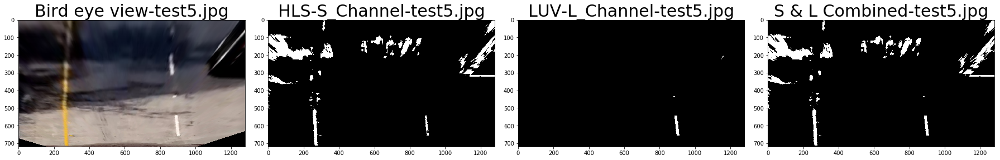

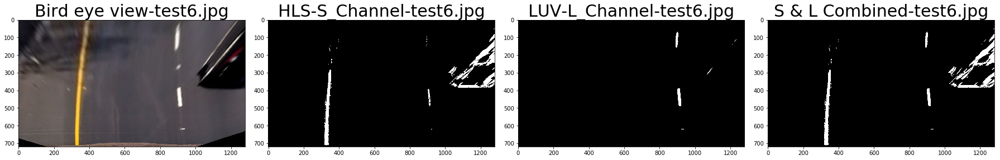

In [5]:
def hls_select( img, channel_select, thresh=( 0, 255 ) ):
    """ Convert to HLS color space and threshold S channel """
    hls = cv2.cvtColor( img, cv2.COLOR_RGB2HLS )
    hls_channel = hls[:,:,channel_select]
    binary_output = np.zeros_like( hls_channel )
    binary_output[ ( hls_channel > thresh[0] ) & ( hls_channel <= thresh[1] ) ] = 1
    return binary_output

def luv_select( img, channel_select, thresh=( 0, 255 ) ):
    """ Convert to LUV color space and threshold L channel """
    luv = cv2.cvtColor( img, cv2.COLOR_RGB2LUV )
    luv_channel = luv[:,:,channel_select]
    binary_output = np.zeros_like( luv_channel )
    binary_output[ ( luv_channel >= thresh[0] ) & ( luv_channel <= thresh[1] ) ] = 1
    return binary_output

def filter_colors( img ):
    """ Filter out HLS-L and LUV-L channels and combine them """
    s_binary = hls_select( img, channel_select = 2, thresh = ( 150, 255 ) )
    l_binary = luv_select( img, channel_select = 0, thresh = ( 225, 255 ) )
    color_combined = np.zeros_like( s_binary )
    color_combined[(l_binary == 1) | (s_binary == 1)] = 1    
    return s_binary, l_binary, color_combined
    
for path in sorted( glob.glob('test_images/test*.jpg')):    
    img = mpimg.imread( path ) 
    _, filename = os.path.split( path )
    undistorted_img = correct_distortion( img )
    warped_img,Minv = perspective_transform( undistorted_img )
    s_binary, l_binary, color_combined = filter_colors( warped_img ) 
    
    f, (ax1, ax2, ax3, ax4) = plt.subplots( 1, 4, figsize=( 25, 10 ) )
    f.subplots_adjust( hspace = .2, wspace=.05 )
    f.tight_layout()
    ax1.imshow( warped_img )
    ax1.set_title( 'Bird eye view-'+filename, fontsize=30 )
    
    ax2.imshow( s_binary,cmap='gray' )
    ax2.set_title( 'HLS-S_Channel-'+filename, fontsize=30 );
    
    ax3.imshow( l_binary,cmap='gray' )
    ax3.set_title( 'LUV-L_Channel-'+filename, fontsize=30 );
    
    ax4.imshow( color_combined,cmap='gray' )
    ax4.set_title( 'S & L Combined-'+filename, fontsize=30 );

## Gradient and Color Threshold

In [6]:
def abs_sobel_thresh( gray, orient='x', sobel_kernel=3, thresh = ( 0, 255 ) ):
    """ Calculate directional gradient using Sobel edges """
    if orient == 'x':
        sobel = cv2.Sobel( gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel )
    elif orient == 'y':
        sobel = cv2.Sobel( gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel )
    sobel = np.absolute(sobel)
    scaled_sobel = np.uint8(255*sobel/np.max(sobel))
    binary_output = np.zeros_like(scaled_sobel)
    binary_output[(scaled_sobel > thresh[0]) & (scaled_sobel < thresh[1])] = 1
    return binary_output

def mag_thresh( gray, sobel_kernel=3, mag_thresh = ( 0, 255 ) ):
    """ Calculate gradient magnitude """
    sobelx = cv2.Sobel( gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel )
    sobely = cv2.Sobel( gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel )
    sobel = np.sqrt( sobelx ** 2 + sobely ** 2 )
    scaled_sobel = np.uint8( 255*sobel/np.max(sobel ) )
    binary_output = np.zeros_like( scaled_sobel )
    binary_output[ ( scaled_sobel > mag_thresh[0] ) & ( scaled_sobel < mag_thresh[1] ) ] = 1
    return binary_output

def dir_threshold( gray, sobel_kernel=3, thresh = ( 0, np.pi/2 ) ):
    """ Calculate gradient direction """
    sobelx = cv2.Sobel( gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel )
    sobely = cv2.Sobel( gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel )
    with np.errstate( divide='ignore', invalid='ignore' ):
        absgraddir = np.absolute( np.arctan(sobely/sobelx ) )
        dir_binary =  np.zeros_like( absgraddir )
        dir_binary[ ( absgraddir > thresh[0] ) & ( absgraddir < thresh[1] ) ] = 1
    return dir_binary

def apply_roi_mask( img ):
    """ Apply region of interest mask """
    if len( img.shape ) > 2: 
        rows,cols,channels = img.shape
        ignore_mask_color = (255,) * channels
    else:
        rows,cols = img.shape
        ignore_mask_color = 255

    mask = np.zeros_like( img )
    # outside perspective roi vertices
    upper_left  = [ 180, 0 ] 
    upper_right = [ 1000, 0 ] 
    lower_left  = [ 180, rows-30 ] 
    lower_right = [ 1000, rows-30 ] 
   
    roi_vertices = np.array( [[ lower_left, upper_left, upper_right, lower_right]], dtype=np.int32 ) 
    cv2.fillPoly( mask, roi_vertices, ignore_mask_color )
    roi_img = cv2.bitwise_and( img, mask )
    return roi_img

def hls_select( img, channel_select, thresh=( 0, 255 ) ):
    """ Convert to HLS color space and threshold S channel """
    hls = cv2.cvtColor( img, cv2.COLOR_RGB2HLS )
    hls_channel = hls[:,:,channel_select]
    binary_output = np.zeros_like( hls_channel )
    binary_output[ ( hls_channel > thresh[0] ) & ( hls_channel <= thresh[1] ) ] = 1
    return binary_output

def luv_select( img, channel_select, thresh=( 0, 255 ) ):
    """ Convert to LUV color space and threshold L channel """
    luv = cv2.cvtColor( img, cv2.COLOR_RGB2LUV )
    luv_channel = luv[:,:,channel_select]
    binary_output = np.zeros_like( luv_channel )
    binary_output[ ( luv_channel >= thresh[0] ) & ( luv_channel <= thresh[1] ) ] = 1
    return binary_output

def hsv_select( img, channel_select, thresh=( 0, 255 ) ):
    """ Convert to LUV color space and threshold L channel """
    luv = cv2.cvtColor( img, cv2.COLOR_RGB2HSV )
    luv_channel = luv[:,:,channel_select]
    binary_output = np.zeros_like( luv_channel )
    binary_output[ ( luv_channel >= thresh[0] ) & ( luv_channel <= thresh[1] ) ] = 1
    return binary_output

def filter_colors( img ):
    """ Filter out HLS-L and LUV-L channels and combine them """
    s_binary = hls_select( img, channel_select = 2, thresh = ( 150, 255 ) )
    l_binary = luv_select( img, channel_select = 0, thresh = ( 225, 255 ) )
    color_combined = np.zeros_like( s_binary )
    color_combined[(l_binary == 1) | (s_binary == 1)] = 1    
    return s_binary, l_binary, color_combined

def gradient_color_threshold( img, apply_roi ):
    """ Apply graient and color thresholding"""
    kernel_size = 7
    
    # Gradient ( Apply sobel edge detection )
    gray = cv2.cvtColor( img, cv2.COLOR_BGR2GRAY )
    gradx = abs_sobel_thresh( gray, orient='x', sobel_kernel=kernel_size, thresh = ( 10, 255 ) )
    grady = abs_sobel_thresh( gray, orient='y', sobel_kernel=kernel_size, thresh = ( 60, 255 ) )
    mag_binary = mag_thresh( gray, sobel_kernel=kernel_size, mag_thresh = ( 40, 255 ) )
    dir_binary = dir_threshold( gray, sobel_kernel=kernel_size, thresh = ( .65, 1.05 ) )
    gradient_combined = np.zeros_like( dir_binary )
    gradient_combined[( (gradx == 1) & (grady == 1)) | ( (mag_binary == 1) & (dir_binary == 1) ) ] = 1
    
    # Color ( Apply HLS, LUV to extra yellow, white lines )
    s_binary, l_binary, color_combined = filter_colors( warped_img ) 
    combined_binary = np.zeros_like( color_combined )
    combined_binary[ ( color_combined > 0 ) | ( gradient_combined > 0 ) ] = 1

    # Filter out extra noise outside the perspective region of intereset 
    if apply_roi:
        combined_binary = apply_roi_mask( combined_binary )
    return combined_binary


## Find lane lines using blind_search()

In [7]:
def blind_search( binary_warped ):
    """ Find and fit lane lines """

    histogram = np.sum(binary_warped[ binary_warped.shape[0]//2:,: ], axis=0 )
    # Create an output image to draw on and visualize the result
    out_img = ( np.dstack( ( binary_warped, binary_warped, binary_warped ) )*255 ).astype('uint8')
    # Find the peak of the left and right halves of the histogram
    # These will be the starting point for the left and right lines
    midpoint = np.int( histogram.shape[0]/2 )
    leftx_base = np.argmax( histogram[100:midpoint] ) + 100
    rightx_base = np.argmax( histogram[midpoint:-100] ) + midpoint

    # Choose the number of sliding windows
    nwindows = 9
    # Set height of windows
    window_height = np.int( binary_warped.shape[0]/nwindows )
    # Identify the x and y positions of all nonzero pixels in the image
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array( nonzero[0] )
    nonzerox = np.array( nonzero[1] )
    # Current positions to be updated for each window
    leftx_current = leftx_base
    rightx_current = rightx_base
    # Set the width of the windows +/- margin
    margin = 100
    # Set minimum number of pixels found to recenter window
    minpix = 50
    # Create empty lists to receive left and right lane pixel indices
    left_indices = []
    right_indices = []

    # Step through the windows one by one
    for window in range(nwindows):
        # Identify window boundaries in x and y (and right and left)
        win_y_low = binary_warped.shape[0] - ( window+1 ) * window_height
        win_y_high = binary_warped.shape[0] - window * window_height
        win_xleft_low = leftx_current - margin
        win_xleft_high = leftx_current + margin
        win_xright_low = rightx_current - margin
        win_xright_high = rightx_current + margin
        # Draw the windows on the visualization image
        cv2.rectangle( out_img,( win_xleft_low,win_y_low ),( win_xleft_high,win_y_high ),(0,255,0), 2)
        cv2.rectangle( out_img,( win_xright_low,win_y_low ),( win_xright_high,win_y_high ),(0,255,0), 2)
        # Identify the nonzero pixels in x and y within the window
        good_left_indices = ( ( nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & (nonzerox >= win_xleft_low) & (nonzerox < win_xleft_high)).nonzero()[0]
        good_right_indices = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & (nonzerox >= win_xright_low) & (nonzerox < win_xright_high)).nonzero()[0]
        # Append these indices to the lists
        left_indices.append( good_left_indices )
        right_indices.append( good_right_indices )
        # If you found > minpix pixels, recenter next window on their mean position
        if len( good_left_indices ) > minpix:
            leftx_current = np.int( np.mean(nonzerox[ good_left_indices ] ) )
        if len( good_right_indices ) > minpix:
            rightx_current = np.int(np.mean( nonzerox[ good_right_indices ] ) )

    # Concatenate the arrays of indices
    left_indices = np.concatenate( left_indices )
    right_indices = np.concatenate( right_indices )

    # Extract left and right line pixel positions
    leftx = nonzerox[ left_indices ]
    lefty = nonzeroy[ left_indices ]
    rightx = nonzerox[ right_indices ]
    righty = nonzeroy[ right_indices ]

    # Fit a second order polynomial to each
    left_fit = np.polyfit( lefty, leftx, 2 )
    right_fit = np.polyfit( righty, rightx, 2 )

    # Package up fit params into a a dictionary 
    fit_params = {}
    fit_params['left_fit'] = left_fit
    fit_params['right_fit'] = right_fit
    fit_params['nonzerox'] = nonzerox
    fit_params['nonzeroy'] = nonzeroy
    fit_params['out_img'] = out_img
    fit_params['left_indices'] = left_indices
    fit_params['right_indices'] = right_indices
    return fit_params


## Visualize blind_search method

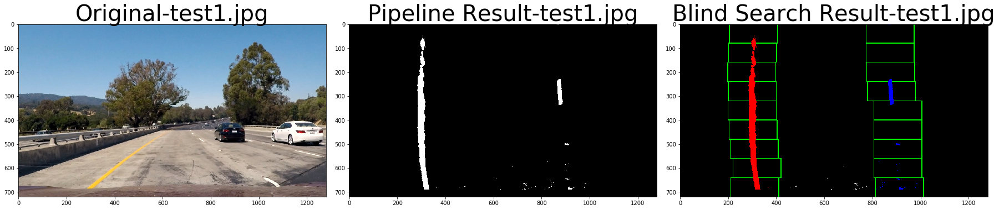

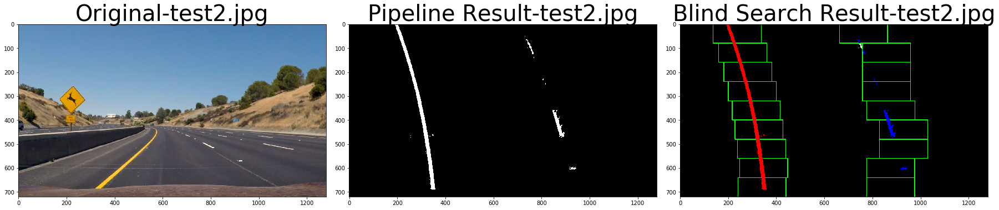

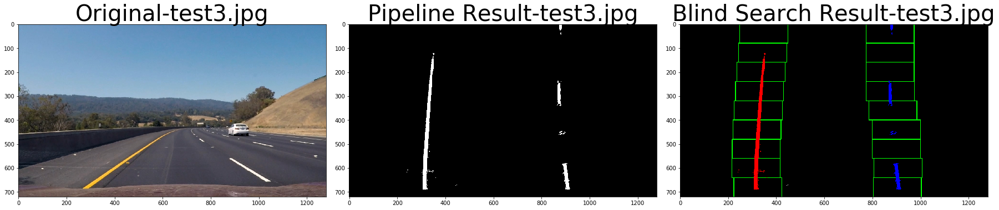

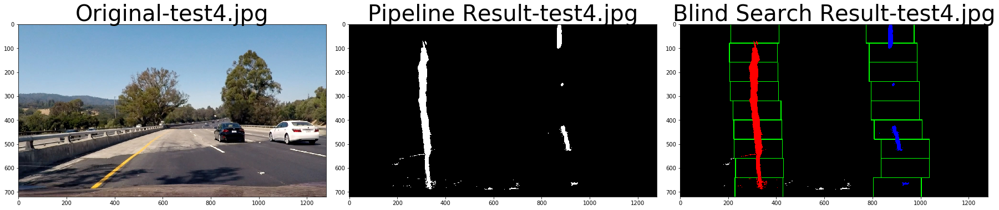

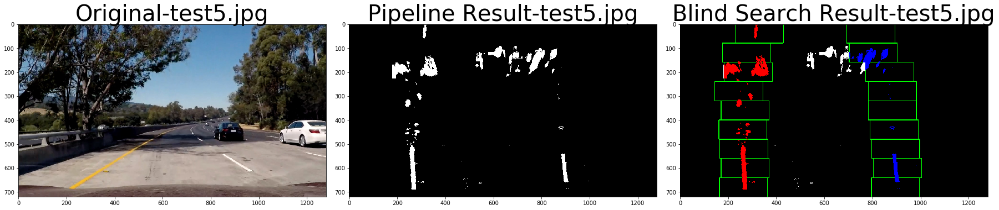

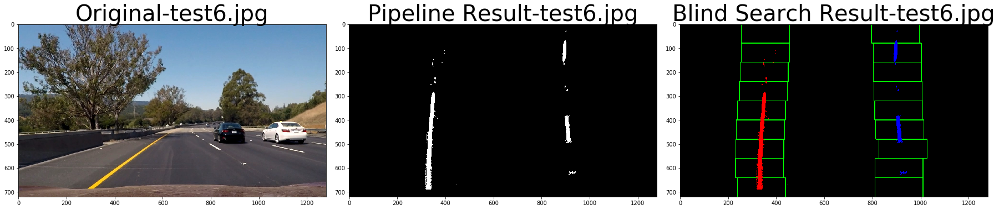

In [8]:
def visualize_blind_search( binary_warped, fit_params ):
    """ Visualize each sliding window location and predicted lane lines """
    
    left_fit = fit_params['left_fit']
    right_fit = fit_params['right_fit']
    nonzerox = fit_params['nonzerox']
    nonzeroy = fit_params['nonzeroy']
    out_img = fit_params['out_img']
    left_indices = fit_params['left_indices']
    right_indices = fit_params['right_indices']

    # Generate x and y values for plotting
    rows = binary_warped.shape[0]
    cols = binary_warped.shape[1]
    ploty = np.linspace( 0, rows-1, rows )
    left_fitx = left_fit[0] * ploty**2 + left_fit[1] * ploty + left_fit[2]
    right_fitx = right_fit[0] * ploty**2 + right_fit[1] * ploty + right_fit[2]

    out_img[ nonzeroy[ left_indices ], nonzerox[ left_indices ] ] = [255, 0, 0]
    out_img[ nonzeroy[ right_indices ], nonzerox[ right_indices ] ] = [0, 0, 255]
    return out_img

for i, path in enumerate( sorted( glob.glob( 'test_images/test*.jpg' ) ) ):
    img = mpimg.imread( path ) 
    _, filename = os.path.split( path )  
    
    undistorted_img = correct_distortion( img )
    warped_img,Minv = perspective_transform( undistorted_img )
    binary_warped = gradient_color_threshold( warped_img, apply_roi=True )
    fit_params = blind_search( binary_warped )
    out_img = visualize_blind_search( binary_warped, fit_params )
        
    f, (ax1, ax2, ax3 ) = plt.subplots( 1, 3, figsize=( 25, 10 ) )
    f.subplots_adjust( hspace = .2, wspace=.05 )
    f.tight_layout()
    ax1.imshow( img )
    ax1.set_title( 'Original-'+filename, fontsize=40 )
    ax2.imshow( binary_warped, cmap='gray' )
    ax2.set_title( 'Pipeline Result-'+filename, fontsize=40 );  
    ax3.imshow( out_img, cmap='gray' )
    ax3.set_title( 'Blind Search Result-'+filename, fontsize=40 );  

## Find line using found_search()

In [9]:
def found_search( binary_warped, left_fit, right_fit ):
    """ Given a previously fit line, quickly try to find the line based on previous lines """
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array( nonzero[0] )
    nonzerox = np.array( nonzero[1] )
    margin = 100
    left_indices = ((nonzerox > (left_fit[0]*(nonzeroy**2) + left_fit[1]*nonzeroy + left_fit[2] - margin)) & (nonzerox < (left_fit[0]*(nonzeroy**2) + left_fit[1]*nonzeroy + left_fit[2] + margin)))
    right_indices = ((nonzerox > (right_fit[0]*(nonzeroy**2) + right_fit[1]*nonzeroy + right_fit[2] - margin)) & (nonzerox < (right_fit[0]*(nonzeroy**2) + right_fit[1]*nonzeroy + right_fit[2] + margin)))

    # Extract left and right line pixel positions
    leftx = nonzerox[ left_indices ]
    lefty = nonzeroy[ left_indices ]
    rightx = nonzerox[ right_indices ]
    righty = nonzeroy[ right_indices ]

    # Return with None is not enough indices
    min_indices = 10
    if lefty.shape[0] < min_indices or righty.shape[0] < min_indices:
        return None

    # Fit a second order polynomial to each lane
    left_fit = np.polyfit( lefty, leftx, 2 )
    right_fit = np.polyfit( righty, rightx, 2 )
    
    ploty = np.linspace( 0, binary_warped.shape[0]-1, binary_warped.shape[0] )
    left_fitx = left_fit[0] * ploty**2 + left_fit[1] * ploty + left_fit[2]
    right_fitx = right_fit[0] * ploty**2 + right_fit[1] * ploty + right_fit[2]

    # package up all relevant fit data into a dictionary
    fit_params = {}
    fit_params['left_fit'] = left_fit
    fit_params['right_fit'] = right_fit
    fit_params['nonzerox'] = nonzerox
    fit_params['nonzeroy'] = nonzeroy
    fit_params['left_indices'] = left_indices
    fit_params['right_indices'] = right_indices
    return fit_params


## Visualize found_ search()

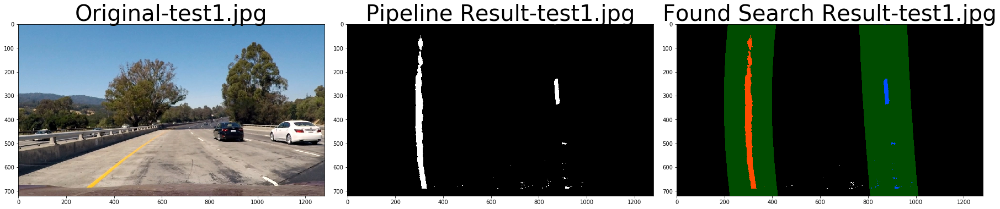

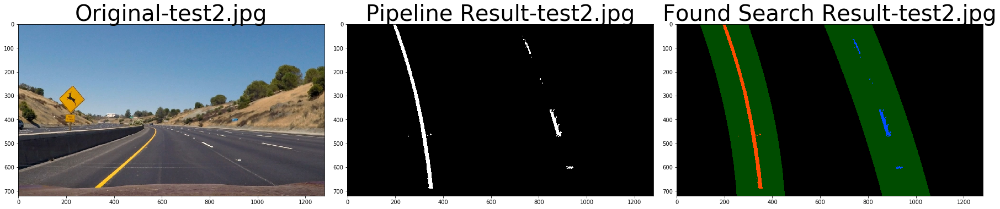

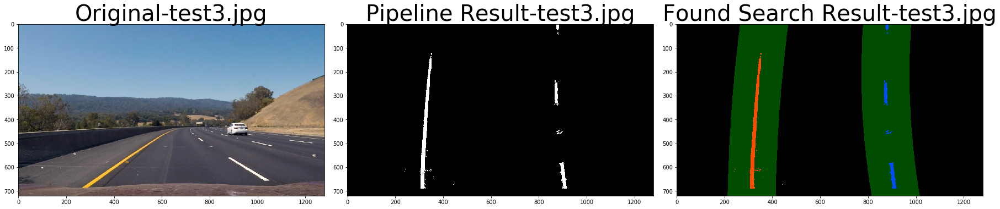

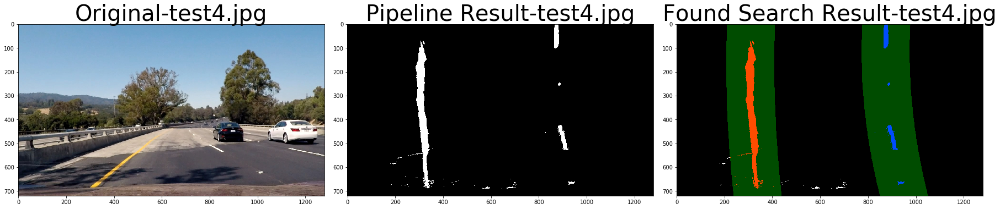

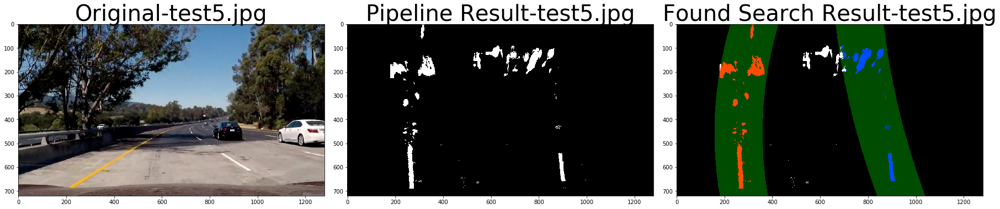

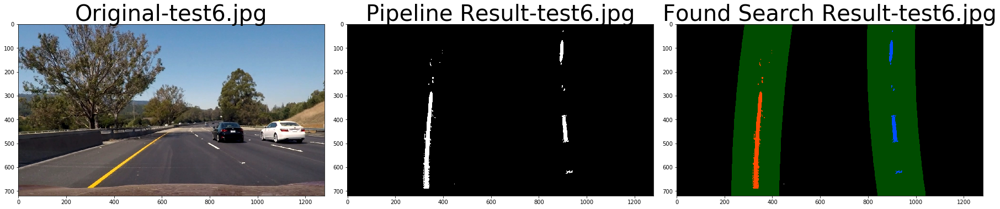

In [10]:
def visualize_found_search( binary_warped, fit_params ):
    """ Visualize the predicted lane lines on previously found line """

    left_fit = fit_params['left_fit']
    right_fit = fit_params['right_fit']
    nonzerox = fit_params['nonzerox']
    nonzeroy = fit_params['nonzeroy']
    left_indices = fit_params['left_indices']
    right_indices = fit_params['right_indices']

    # Create an output image
    out_img = ( np.dstack( ( binary_warped, binary_warped, binary_warped ) )*255).astype('uint8')
    window_img = np.zeros_like( out_img )
    out_img[ nonzeroy[ left_indices ], nonzerox[ left_indices ] ] = [255, 0, 0]
    out_img[ nonzeroy[ right_indices ], nonzerox[ right_indices ] ] = [0, 0, 255]

    # Generate x and y values for plotting
    ploty = np.linspace( 0, binary_warped.shape[0]-1, binary_warped.shape[0])
    left_fitx = left_fit[0] * ploty**2 + left_fit[1] * ploty + left_fit[2]
    right_fitx = right_fit[0] * ploty**2 + right_fit[1] * ploty + right_fit[2]

    margin = 100
    left_line_window1 = np.array( [ np.transpose( np.vstack( [ left_fitx-margin, ploty] ) ) ] )
    left_line_window2 = np.array( [ np.flipud( np.transpose( np.vstack( [ left_fitx+margin, ploty ] ) ) ) ] )
    left_line_pts = np.hstack( ( left_line_window1, left_line_window2 ) )
    right_line_window1 = np.array( [ np.transpose( np.vstack( [ right_fitx-margin, ploty ] ) ) ] )
    right_line_window2 = np.array( [ np.flipud( np.transpose( np.vstack( [ right_fitx + margin, ploty ] ) ) ) ] )
    right_line_pts = np.hstack( ( right_line_window1, right_line_window2 ) )

    # Draw each lane
    cv2.fillPoly(window_img, np.int_( [ left_line_pts ] ), (0,255, 0) )
    cv2.fillPoly(window_img, np.int_( [ right_line_pts ] ), (0,255, 0) )
    result = cv2.addWeighted( out_img, 1, window_img, 0.3, 0 )
    return result

for i, path in enumerate( sorted( glob.glob( 'test_images/test*.jpg' ) ) ):
    img = mpimg.imread( path ) 
    _, filename = os.path.split( path )  
    
    undistorted_img = correct_distortion( img )
    warped_img,Minv = perspective_transform( undistorted_img )
    binary_warped = gradient_color_threshold( warped_img, apply_roi=True )    
    fit_params = blind_search( binary_warped )
    left_fit  = fit_params['left_fit']
    right_fit = fit_params['right_fit']
    fit_params = found_search( binary_warped, left_fit, right_fit )
    out_img = visualize_found_search( binary_warped, fit_params )
        
    f, (ax1, ax2, ax3 ) = plt.subplots( 1, 3, figsize=( 25, 10 ) )
    f.subplots_adjust( hspace = .2, wspace=.05 )
    f.tight_layout()
    ax1.imshow( img )
    ax1.set_title( 'Original-'+filename, fontsize=40 )
    ax2.imshow( binary_warped, cmap='gray' )
    ax2.set_title( 'Pipeline Result-'+filename, fontsize=40 );  
    ax3.imshow( out_img, cmap='gray' )
    ax3.set_title( 'Found Search Result-'+filename, fontsize=40 );  

## Calculate Radius of Curvature and Center Offset

In [11]:
def calc_radius( left_indices, right_indices, nonzerox, nonzeroy ):
    """ Calculate radius of curvature in meters """
    rows = 720
    # Define conversions in x and y from pixels space to meters
    ym_per_pix = 30/rows # meters per pixel in y dimension
    xm_per_pix = 3.7/700 # meters per pixel in x dimension

    leftx = nonzerox[ left_indices ]
    lefty = nonzeroy[ left_indices ]
    rightx = nonzerox[right_indices ]
    righty = nonzeroy[ right_indices ]

    # Fit new polynomials
    left_fit_cr = np.polyfit( lefty * ym_per_pix, leftx * xm_per_pix, 2 )
    right_fit_cr = np.polyfit( righty * ym_per_pix, rightx * xm_per_pix, 2 )
    
    # Radius of curvature
    left_curve_radius = ( ( 1 + ( 2*left_fit_cr[0] * (rows-1) * ym_per_pix + left_fit_cr[1] )**2)**1.5 ) / np.absolute( 2 * left_fit_cr[0] )
    right_curve_radius = ( ( 1 + ( 2*right_fit_cr[0] * (rows-1) * ym_per_pix + right_fit_cr[1] )**2)**1.5 ) / np.absolute( 2 * right_fit_cr[0])
    avg_radius = ( left_curve_radius + right_curve_radius ) / 2
    avg_radius_str = 'Radius of curvature: %.2f m' % avg_radius
    return avg_radius_str

def calc_center_offset( undistorted_img, left_fit, right_fit ):
    """ Calculate center offset from lane center, in meters """
    bottom_y = undistorted_img.shape[0] - 1
    bottom_x_left = left_fit[0] * ( bottom_y**2) + left_fit[1] * bottom_y + left_fit[2]
    bottom_x_right = right_fit[0] * ( bottom_y**2) + right_fit[1]*bottom_y + right_fit[2]
    center_offset = undistorted_img.shape[1]/2 - ( bottom_x_left + bottom_x_right )/2

    # Convert pixel offset to meters
    xm_per_pix = 3.7/700 # meters per pixel in x dimension
    center_offset *= xm_per_pix
    center_offset_str = 'Center Offset: %.2f m' % center_offset
    return center_offset_str


## Define fill_lane() to annotate video images with predictions

In [12]:
def fill_lane( undistorted_img, left_fit, right_fit, Minv, avg_radius_str, car_offset_str ):    
    """ Fill in lane prediction polygon and print predictions on image """

    rows = undistorted_img.shape[0]
    cols = undistorted_img.shape[1]
    
    ploty = np.linspace( 0, rows-1, rows )
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]

    color_warp = np.zeros( ( rows, cols, 3 ), dtype='uint8' )

    left_points = np.array( [ np.transpose(np.vstack( [ left_fitx, ploty ] ) ) ] )
    right_points = np.array( [ np.flipud( np.transpose( np.vstack( [ right_fitx, ploty ] ) ) ) ] )
    points = np.hstack( ( left_points, right_points ) )

    # Fill in the lane points 
    cv2.fillPoly( color_warp, np.int_( [points] ), ( 0,255, 0 ) )

    # Get original image via inverse perspective transform
    inverse_warp = cv2.warpPerspective( color_warp, Minv, (cols, rows ) )
    result = cv2.addWeighted( undistorted_img, 1, inverse_warp, 0.3, 0)

    # Annotate radius and center offset
    result = cv2.putText(result, avg_radius_str, (30,40), 0, 1, (0,0,0), 2, cv2.LINE_AA)
    result = cv2.putText(result, car_offset_str, (30,70), 0, 1, (0,0,0), 2, cv2.LINE_AA)
    return result


## Define a Line class for to manage run time lane predictions

In [13]:
class Line( ):
    def __init__(self):    
        self.line_found = False
        # Coefficients for 2nd order polynomial and average
        self.y0 = []
        self.y1 = []
        self.y2 = []

        self.y0_avg = 0.
        self.y1_avg = 0.
        self.y2_avg = 0.        
        
    def get_fit( self ):
        return ( self.y0_avg, self.y1_avg, self.y2_avg )
    
    def add_fit( self, coefficients ):
        """ Add smoothed coefficients """
        self.y0.append( coefficients[0] )
        self.y1.append( coefficients[1] )
        self.y2.append( coefficients[2] )

        if len ( self.y0 ) >= 10:    
            _ = self.y0.pop( 0 )
            _ = self.y1.pop( 0 )
            _ = self.y2.pop( 0 )

        self.y0_avg = np.mean( self.y0 )
        self.y1_avg = np.mean( self.y1 )
        self.y2_avg = np.mean( self.y2 )

        return ( self.y0_avg, self.y1_avg, self.y2_avg )

## Video Pipeline

In [14]:
def video_pipeline( img ):
    global line_detected
    line_detected = False

    undistorted_img = correct_distortion( img )
    warped_img,Minv = perspective_transform( undistorted_img )
    binary_warped = gradient_color_threshold( warped_img, apply_roi=True )
    
    if line_detected == False:
        fit_params = blind_search( binary_warped )
        left_fit = fit_params['left_fit']
        right_fit = fit_params['right_fit']
        nonzerox = fit_params['nonzerox']
        nonzeroy = fit_params['nonzeroy']
        left_indices = fit_params['left_indices']
        right_indices = fit_params['right_indices']
        left_fit = left_line.add_fit( left_fit )
        right_fit = right_line.add_fit( right_fit )
        avg_radius_str = calc_radius( left_indices, right_indices, nonzerox, nonzeroy )
        line_detected = True

    else:
        left_fit = left_line.get_fit()
        right_fit = right_line.get_fit()
        fit_params = found_search( binary_warped, left_fit, right_fit )
        left_fit = fit_params['left_fit']
        right_fit = fit_params['right_fit']
        nonzerox = fit_params['nonzerox']
        nonzeroy = fit_params['nonzeroy']
        left_indices = fit_params['left_indices']
        right_indices = fit_params['right_indices']

        if fit_params is not None:
            left_fit = fit_params['left_fit']
            right_fit = fit_params['right_fit']
            nonzerox = fit_params['nonzerox']
            nonzeroy = fit_params['nonzeroy']
            left_indices = fit_params['left_indices']
            right_indices = fit_params['right_indices']
            left_fit = left_line.add_fit( left_fit )
            right_fit = right_line.add_fit( right_fit )
            avg_radius_str = calc_radius( left_indices, right_indices, nonzerox, nonzeroy )
        else:
            line_detected = False

    car_offset_str = calc_center_offset( undistorted_img, left_fit, right_fit )
    result = fill_lane( undistorted_img, left_fit, right_fit, Minv, avg_radius_str, car_offset_str )

    return result

## Run the Video Pipeline on project_video.mp4

In [15]:
# Step 1 Calibrate Camera (Only need to do this once)
calibrate_camera( img, plot=False )
print("Camera Calibrated")

left_line = Line()
right_line = Line()

video_output = 'project_video_output.mp4'
clip1 = VideoFileClip( 'project_video.mp4' )
clip1_video = clip1.fl_image( video_pipeline )
%time clip1_video.write_videofile( video_output, audio=False)


Camera Calibrated
[MoviePy] >>>> Building video project_video_output.mp4
[MoviePy] Writing video project_video_output.mp4


100%|█████████▉| 1260/1261 [27:29<00:01,  1.28s/it]


[MoviePy] Done.
[MoviePy] >>>> Video ready: project_video_output.mp4 

CPU times: user 27min 52s, sys: 6.68 s, total: 27min 59s
Wall time: 27min 31s


## Run the Video Pipeline on challenge_video.mp4

In [16]:
left_line = Line()
right_line = Line()

video_output = 'challenge_video_output.mp4'
clip2 = VideoFileClip( 'challenge_video.mp4' )
clip2_video = clip1.fl_image( video_pipeline )
%time clip2_video.write_videofile( video_output, audio=False)


[MoviePy] >>>> Building video challenge_video_output.mp4
[MoviePy] Writing video challenge_video_output.mp4


100%|█████████▉| 1260/1261 [27:53<00:01,  1.29s/it]


[MoviePy] Done.
[MoviePy] >>>> Video ready: challenge_video_output.mp4 

CPU times: user 28min 11s, sys: 7.79 s, total: 28min 19s
Wall time: 27min 55s
